In [2]:
import tensorflow as tf
import numpy as np
import os
from PIL import Image

In [3]:
def Bilinear(orig_image, new_width, new_height):
    new_image = np.zeros((new_height, new_width, 3), dtype=np.uint8)
    for i in range(new_height):
        for j in range(new_width):
            x = j / new_width * orig_image.shape[1]
            y = i / new_height * orig_image.shape[0]
            x1 = int(x)
            y1 = int(y)
            x2 = x1 + 1
            y2 = y1 + 1
            if x2 >= orig_image.shape[1]:
                x2 = x1
            if y2 >= orig_image.shape[0]:
                y2 = y1
            dx = x - x1
            dy = y - y1
            new_image[i, j] = (1 - dx) * (1 - dy) * orig_image[y1, x1] + dx * (1 - dy) * orig_image[y1, x2] + (1 - dx) * dy * orig_image[y2, x1] + dx * dy * orig_image[y2, x2]
    return new_image

In [4]:
labels = ['OpenHand','ClosedHand']
y_train = []
y_train_pos = []
x_train = []
path = "Data/JPG/Images"
path2 = "Data/PNG/Images"
for i in os.listdir(path):
    for j in os.listdir(path + "/" + i):
        im =  Image.open(path + "/" + i + '/' + j)
        im = Bilinear(np.array(im), 240, 240)
        #im = np.expand_dims(im,axis = 2)
        x_train.append(im)
        y_train.append(labels.index(i))

for i in os.listdir(path2):
    for j in os.listdir(path2 + "/" + i):
        im =  Image.open(path2 + "/" + i + '/' + j)
        im = np.array(im)
        #im = np.expand_dims(im,axis = 2)
        x_train.append(im)
        y_train.append(labels.index(i))

x = np.array(x_train)
y = tf.keras.utils.to_categorical(y_train)

print(x.shape)
print(y.shape)

(602, 240, 240, 3)
(602, 2)


In [5]:
from sklearn.model_selection import train_test_split

x_train, x_val, y_train, y_val = train_test_split(x, y, train_size=0.80, random_state=42)

In [6]:
input = tf.keras.layers.Input(shape=(240, 240, 3))
x = tf.keras.layers.Conv2D(16, (3, 3), activation='relu')(input)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(32, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(64, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Conv2D(128, (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(x)
x = tf.keras.layers.Flatten()(x)

x = tf.keras.layers.Dense(64, activation='relu', kernel_regularizer=tf.keras.regularizers.L2(0.01))(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.L2(0.01))(x)
x = tf.keras.layers.Dropout(0.5)(x)
x = tf.keras.layers.Dense(2, activation='softmax', kernel_regularizer=tf.keras.regularizers.L2(0.01))(x)

# x = tf.keras.layers.Dense(32, activation='relu', kernel_regularizer = tf.keras.regularizers.l1_l2(l1 = 0.05,l2 = 0.5), bias_regularizer=tf.keras.regularizers.l2(0.1))(x)
# x = tf.keras.layers.Dropout(0.5)(x)
# x = tf.keras.layers.Dense(2, activation='softmax', kernel_regularizer = tf.keras.regularizers.l1_l2(l1 = 0.05,l2 = 0.5), bias_regularizer=tf.keras.regularizers.l2(0.1))(x)

model = tf.keras.Model(input, x)

checkpoint_filepath = "checkpoints/"
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics='accuracy')

model.fit(x_train, y_train, epochs=1000, batch_size=64, validation_data=(x_val, y_val), callbacks=[model_checkpoint_callback])

model.load_weights(checkpoint_filepath)




Epoch 1/1000


8/8 [==============================] - 7s 573ms/step - loss: 7.4952 - accuracy: 0.5073 - val_loss: 2.1958 - val_accuracy: 0.5124
Epoch 2/1000
8/8 [==============================] - 4s 502ms/step - loss: 2.1061 - accuracy: 0.4823 - val_loss: 1.9622 - val_accuracy: 0.5455
Epoch 3/1000
8/8 [==============================] - 4s 513ms/step - loss: 1.9657 - accuracy: 0.4719 - val_loss: 1.9490 - val_accuracy: 0.4959
Epoch 4/1000
8/8 [==============================] - 4s 498ms/step - loss: 1.9353 - accuracy: 0.4927 - val_loss: 1.9124 - val_accuracy: 0.4876
Epoch 5/1000
8/8 [==============================] - 4s 476ms/step - loss: 1.8855 - accuracy: 0.5114 - val_loss: 1.8621 - val_accuracy: 0.4876
Epoch 6/1000
8/8 [==============================] - 4s 491ms/step - loss: 1.8455 - accuracy: 0.5135 - val_loss: 1.8170 - val_accuracy: 0.4876
Epoch 7/1000
8/8 [==============================] - 4s 490ms/step - loss: 1.7964 - accuracy: 0.5052 - val_loss: 1.7704 - val_accuracy: 0.4876
E

In [7]:
# Execute Cell Index 3 first to define and train the model

loss, accuracy = model.evaluate(x_val, y_val)

print("Loss", loss)
print("Accuracy", accuracy)



4/4 [==============================] - 0s 61ms/step - loss: 0.2806 - accuracy: 1.0000
Loss 0.28055477142333984
Accuracy 1.0


In [12]:
predictions = model.predict(x_val[0].reshape(1, 240, 240, 3))

print(predictions)



1/1 [==============================] - 0s 186ms/step
[[0.97302276 0.02697727]]


In [8]:
import tf2onnx

tf2onnx.convert.from_keras(model, output_path="handV2_5.onnx")

(ir_version: 8
 producer_name: "tf2onnx"
 producer_version: "1.16.1 15c810"
 graph {
   node {
     input: "input_1"
     output: "model/conv2d/BiasAdd__6:0"
     name: "model/conv2d/BiasAdd__6"
     op_type: "Transpose"
     attribute {
       name: "perm"
       ints: 0
       ints: 3
       ints: 1
       ints: 2
       type: INTS
     }
   }
   node {
     input: "model/conv2d/BiasAdd__6:0"
     input: "model/conv2d/Conv2D/ReadVariableOp:0"
     input: "model/conv2d/BiasAdd/ReadVariableOp:0"
     output: "model/conv2d/BiasAdd:0"
     name: "model/conv2d/BiasAdd"
     op_type: "Conv"
     attribute {
       name: "dilations"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "strides"
       ints: 1
       ints: 1
       type: INTS
     }
     attribute {
       name: "kernel_shape"
       ints: 3
       ints: 3
       type: INTS
     }
     attribute {
       name: "group"
       i: 1
       type: INT
     }
     domain: ""
   }
   node {
     inpu

[array([[1.000000e+00, 5.108532e-09]], dtype=float32)]


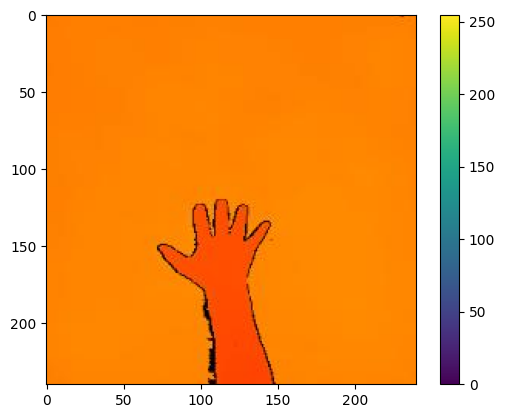

Palm


In [2]:
import onnxruntime
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

labels = ['Palm','Fist']
img = Image.open("SavedScreen6.jpg")
img = np.array(img)

# Load the ONNX model
sess = onnxruntime.InferenceSession("handV2_5.onnx")
intput_name = sess.get_inputs()[0].name
output_name = sess.get_outputs()[0].name
image = img.astype(np.float32)

onnx_predicted_label = sess.run(output_names=[output_name], input_feed={intput_name: image.reshape(1,240,240,3)})
print(onnx_predicted_label)

plt.figure()
plt.imshow(img)
plt.colorbar()
plt.grid(False)
plt.show()
print(labels[np.argmax(onnx_predicted_label)])

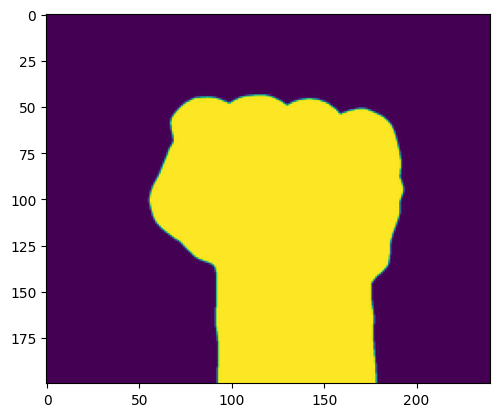

(1, 200, 240, 1)


In [41]:
img = Image.open("okay3.png")
for i in range(img.size[0]):
    for j in range(img.size[1]):
        if img.getpixel((i, j))[0] > 230 and img.getpixel((i, j))[1] > 230 and img.getpixel((i, j))[2] > 230:
            img.putpixel((i, j), (0,0,0))
        else:
            img.putpixel((i, j), (255, 255, 255))
img = img.convert('L')
img = img.resize((240, 200), Image.LANCZOS)
img = np.array(img)
plt.imshow(img)
plt.show()
img = img.reshape(1, 200, 240, 1)
print(img.shape)


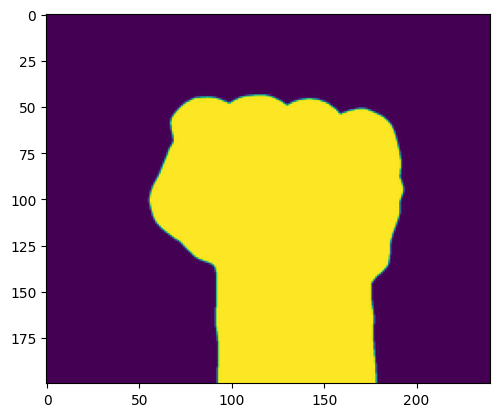

rock
[array([[3.1971749e-07, 1.3945986e-08, 9.9999964e-01]], dtype=float32)]


In [42]:
predictions = onnx_predicted_label = sess.run(output_names=[output_name], input_feed={intput_name: img.astype(np.float32)})
plt.imshow(img.reshape(200, 240))
plt.show()
print(labels[np.argmax(predictions)])
print(predictions)